# Required imports

In [1]:
# Required imports
from collections import namedtuple
import numpy as np
import datetime
from netCDF4 import Dataset
import configparser
from matplotlib import pyplot as plt
from cftime import num2pydate
import cartopy.crs as ccrs
from mpl_toolkits.axes_grid1 import make_axes_locatable
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from pylag.regrid import regridder
from pylag.processing.ncview import Viewer
from pylag.processing.plot import FVCOMPlotter
from pylag.processing.plot import create_figure
from pylag.processing.utils import get_grid_bands

In [2]:
# Read the path to Data 
import os 
data_dir='/home/samin/data/FVCOME_OUTPUT/Gldata/FVCOMEDATA/202301'.format(os.environ['HOME']) # for june
# Create run directory
cwd = os.getcwd()
# Create run directory
simulation_dir = '/home/samin/data/FVCOME_OUTPUT/simulations/horon'.format(cwd)
try:
    os.makedirs(simulation_dir)
except FileExistsError:
    pass

# Create input sub-directory
input_dir =  '{}/input'.format(simulation_dir)
try:
    os.makedirs(input_dir)
except FileExistsError:
    pass

# Create Grid metrics file "FVCOME method"

In [3]:
from pylag.grid_metrics import create_fvcom_grid_metrics_file
#path to FVCOM output file
fvcom_file_name = '/home/samin/data/FVCOME_OUTPUT/Gldata/FVCOMEDATA/202306/Fvcome_houron_estuary_20230601.t00z.nc'
# The file listing the location of open boundary nodes
obc_file_name = '/home/samin/data/FVCOME_OUTPUT/fvcom_open_node_obc.dat'
# The name of the output file
grid_metrics_file_name = f'{input_dir}/grid_metrics_huron_fvcomnode.nc'

# Generate the file
create_fvcom_grid_metrics_file(fvcom_file_name, obc_file_name = obc_file_name,
                               grid_metrics_file_name=grid_metrics_file_name)


Creating FVCOM grid metrics file /home/samin/data/FVCOME_OUTPUT/simulations/horon/input/grid_metrics_huron_fvcomnode.nc
INFO - detected longitudes greater than 180.0 in variable lon. Assuming longitude limits are in the range 0 - 360. Correcting these to be in the range -180 to 180.
INFO - detected longitudes greater than 180.0 in variable lonc. Assuming longitude limits are in the range 0 - 360. Correcting these to be in the range -180 to 180.
Grid has 2 nodes on the open boundary


# Read Bathymetry

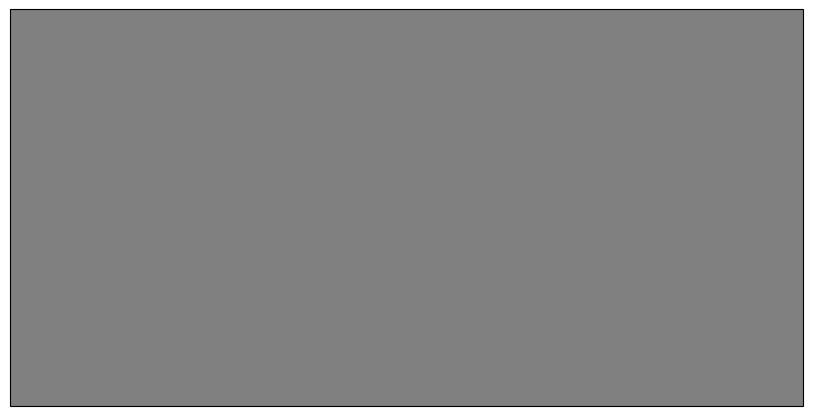

In [4]:
from pylag.processing.plot import FVCOMPlotter
from pylag.processing.plot import create_figure, colourmap
# Create figure
font_size = 15
cmap = colourmap('h_r')
ig, ax = create_figure(figure_size=(26., 26.), projection=ccrs.PlateCarree(),
                      font_size=font_size, bg_color='gray')

#grid_metrics_file_name = f"{input_dir}/grid_metrics_huron_senseflux.nc"
grid_metrics_file_name = f"{input_dir}/grid_metrics_huron_senseflux_202306.nc"

# Read in the bathymetry
ds = Dataset(grid_metrics_file_name, 'r')
bathy = -ds.variables['h'][:]
ds.close()
del(ds)

In [9]:
import configparser
#config_file_name = '/home/samin/data/FVCOME_OUTPUT/confings/huron_senseflux.cfg'
config_file_name = '/home/samin/data/FVCOME_OUTPUT/confings/huron_senseflux_202306_differentinitial.cfg'


cf = configparser.ConfigParser()
cf.read(config_file_name)

# Start time
print('Start time: {}'.format(cf.get('SIMULATION', 'start_datetime')))

# End time
print('End time: {}'.format(cf.get('SIMULATION', 'end_datetime')))

# Specify that this is a forward tracking experiment
print('Time direction: {}'.format(cf.get('SIMULATION', 'time_direction')))

# We will do a single run, rather than an ensemble run
print('Number of particle releases: {}'.format(cf.get('SIMULATION', 'number_of_particle_releases')))

# Use depth restoring, and restore particle depths to the ocean surface
print('Use depth restoring: {}'.format(cf.get('SIMULATION', 'depth_restoring')))
print('Restore particles to a depth of: {} m'.format(cf.get('SIMULATION', 'fixed_depth')))

# Specify that we are working with FVCOM in cartesian coordinates
print('Model name: {}'.format(cf.get('OCEAN_DATA', 'name')))
print('Coordinate system: {}'.format(cf.get('SIMULATION', 'coordinate_system')))

# Set the location of the grid metrics and input files
print('Data directory: {}'.format(cf.get('OCEAN_DATA', 'data_dir')))
print('Path to grid metrics file: {}'.format(cf.get('OCEAN_DATA', 'grid_metrics_file')))
print('File name stem of input files: {}'.format(cf.get('OCEAN_DATA', 'data_file_stem')))
      
# Do an advection only run using a RK$ intergration scheme 
print('Numerical method: {}'.format(cf.get('NUMERICS', 'num_method')))
print('Iterative method: {}'.format(cf.get('NUMERICS', 'iterative_method')))

Start time: 2023-01-01  00:00:00
End time: 2023-01-31  11:50:07
Time direction: forward
Number of particle releases: 100
Use depth restoring: True
Restore particles to a depth of: 0.0 m
Model name: FVCOM
Coordinate system: geographic
Data directory: /home/samin/data/FVCOME_OUTPUT/Gldata/FVCOMEDATA/202301
Path to grid metrics file: /home/samin/data/FVCOME_OUTPUT/simulations/horon/input/grid_metrics_huron.nc
File name stem of input files: Fvcome_houron_estuary
Numerical method: standard
Iterative method: Adv_RK4_3D


In [10]:
cf.set('OCEAN_DATA', 'data_dir', data_dir)
cf.set('OCEAN_DATA', 'grid_metrics_file', grid_metrics_file_name)

# Save a copy in the simulation directory
with open(f"{simulation_dir}/pylag.cfg", 'w') as config:
    cf.write(config)

In [11]:
# Change to the run directory
os.chdir(f"{simulation_dir}")

# Run the model
!{"python -m pylag.main -c pylag.cfg"}

# Return to the cwd
os.chdir(cwd)


Starting ensemble member 1 ...
Progress:
100% |###########################################|

Starting ensemble member 2 ...
Progress:
100% |###########################################|

Starting ensemble member 3 ...
Progress:
100% |###########################################|

Starting ensemble member 4 ...
Progress:
100% |###########################################|

Starting ensemble member 5 ...
Progress:
100% |###########################################|

Starting ensemble member 6 ...
Progress:
100% |###########################################|

Starting ensemble member 7 ...
Progress:
100% |###########################################|

Starting ensemble member 8 ...
Progress:
100% |###########################################|

Starting ensemble member 9 ...
Progress:
100% |###########################################|

Starting ensemble member 10 ...
Progress:
100% |###########################################|

Starting ensemble member 11 ...
Progress:
100% |####################

# Plot

/root/miniconda3/envs/pylag/lib/python3.11/site-packages/pylag/processing/plot.py:1684: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure = plt.figure(figsize=figure_size_inches)


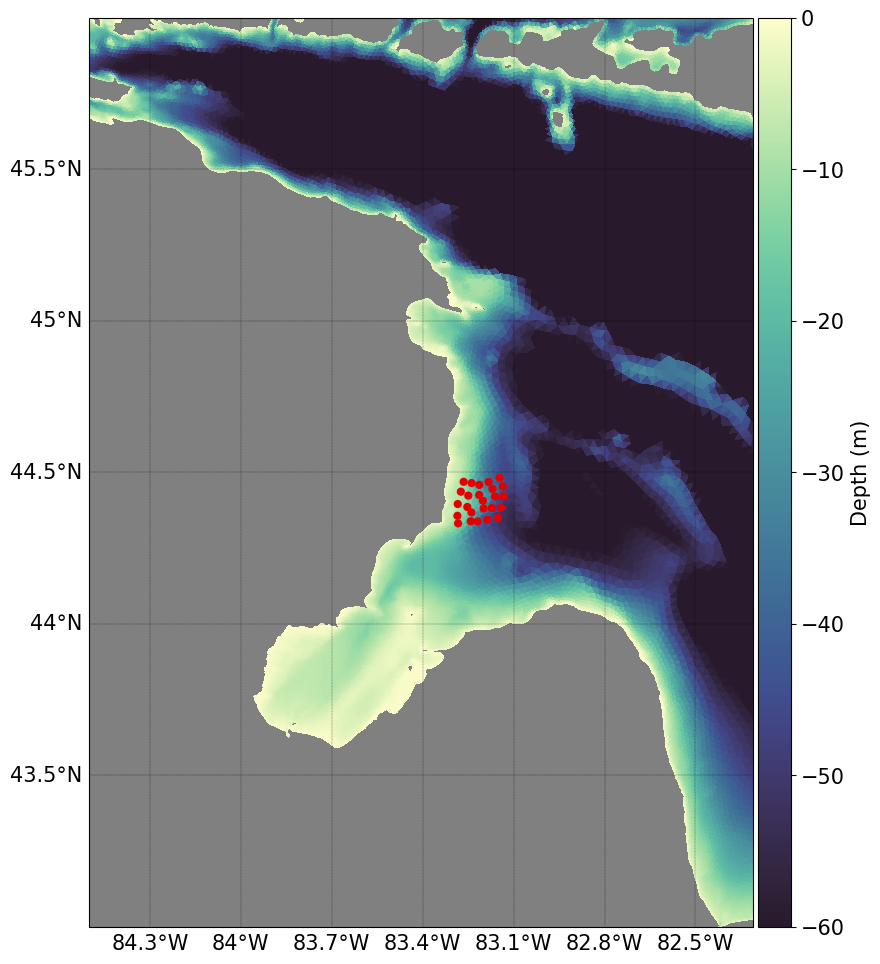

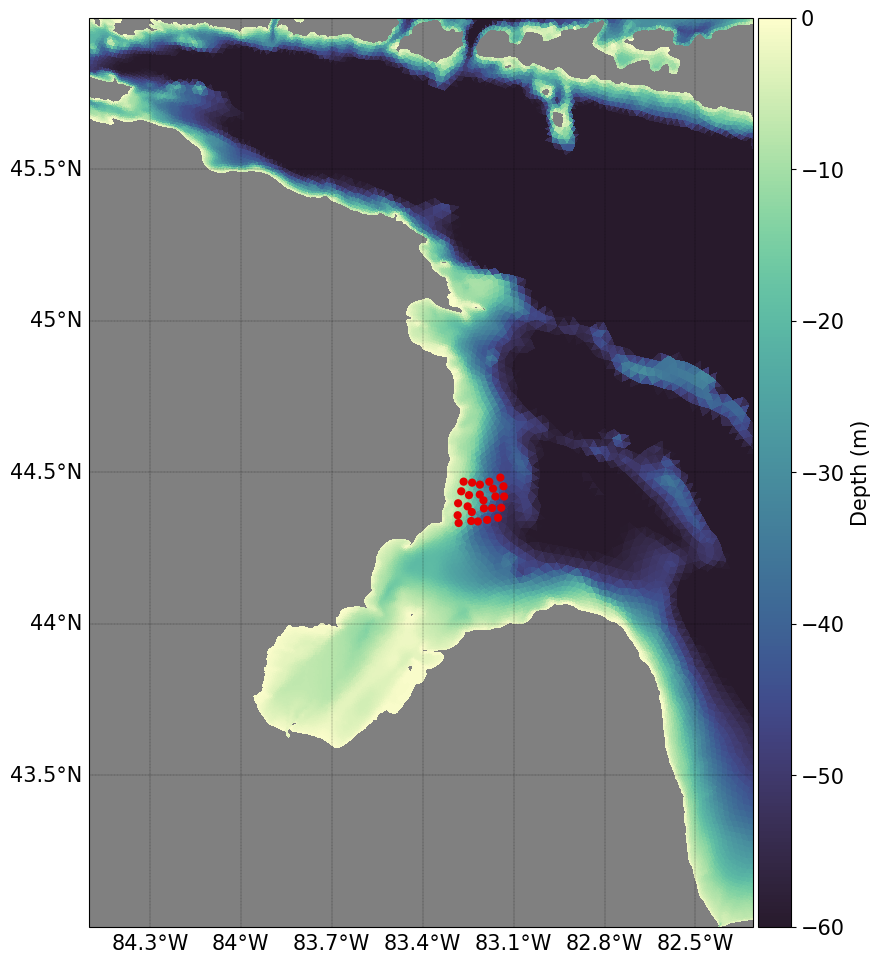

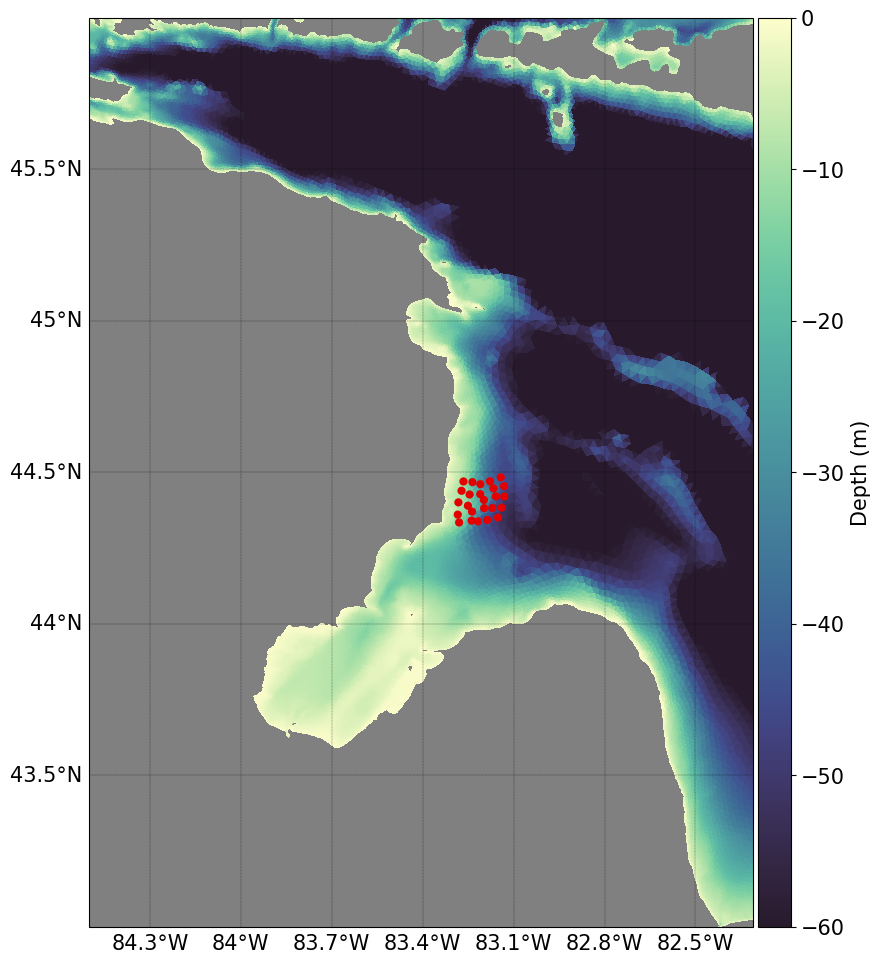

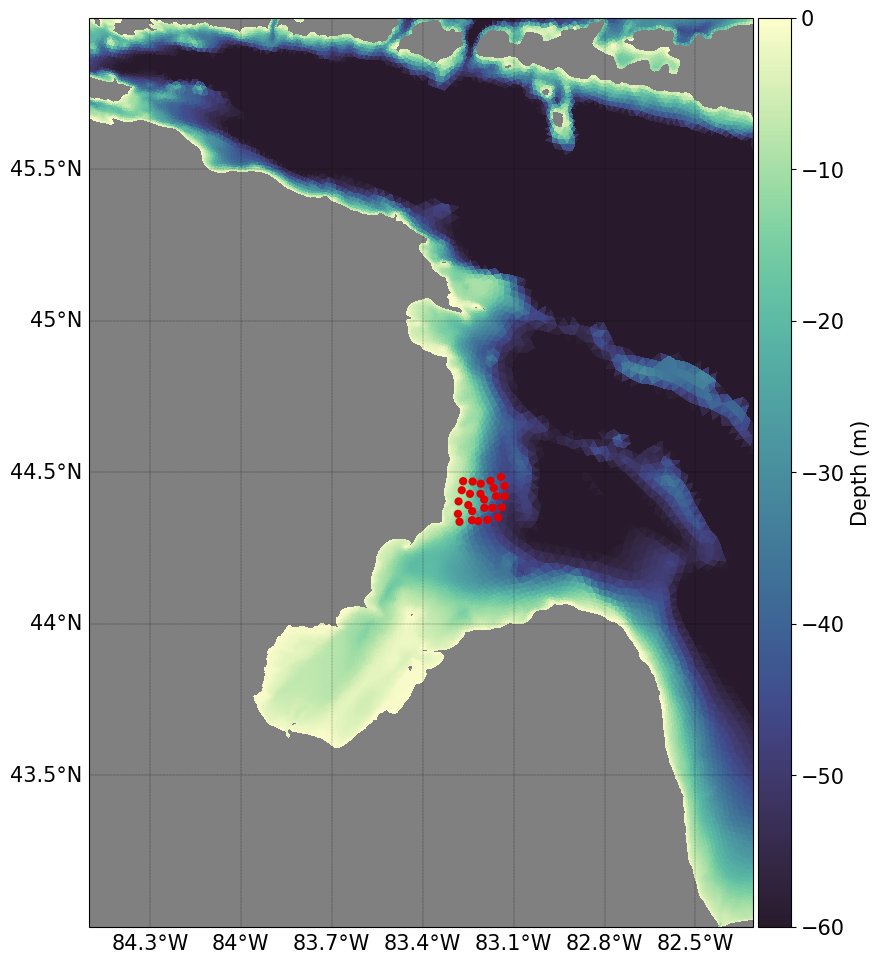

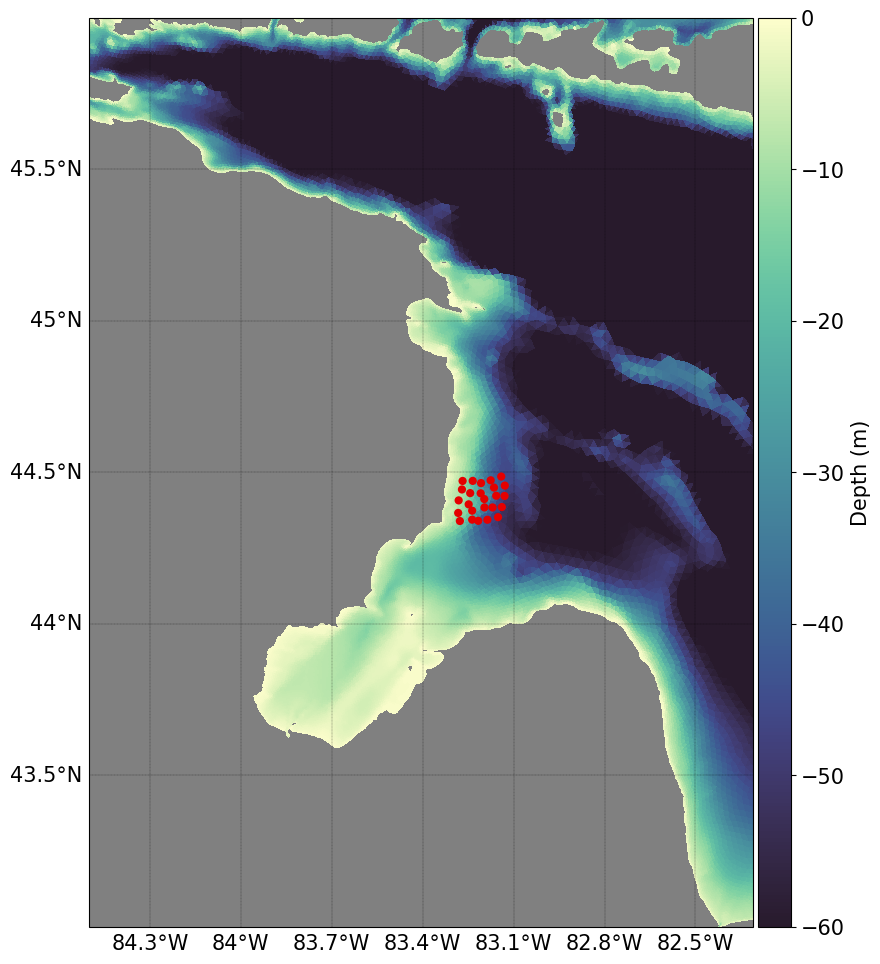

...

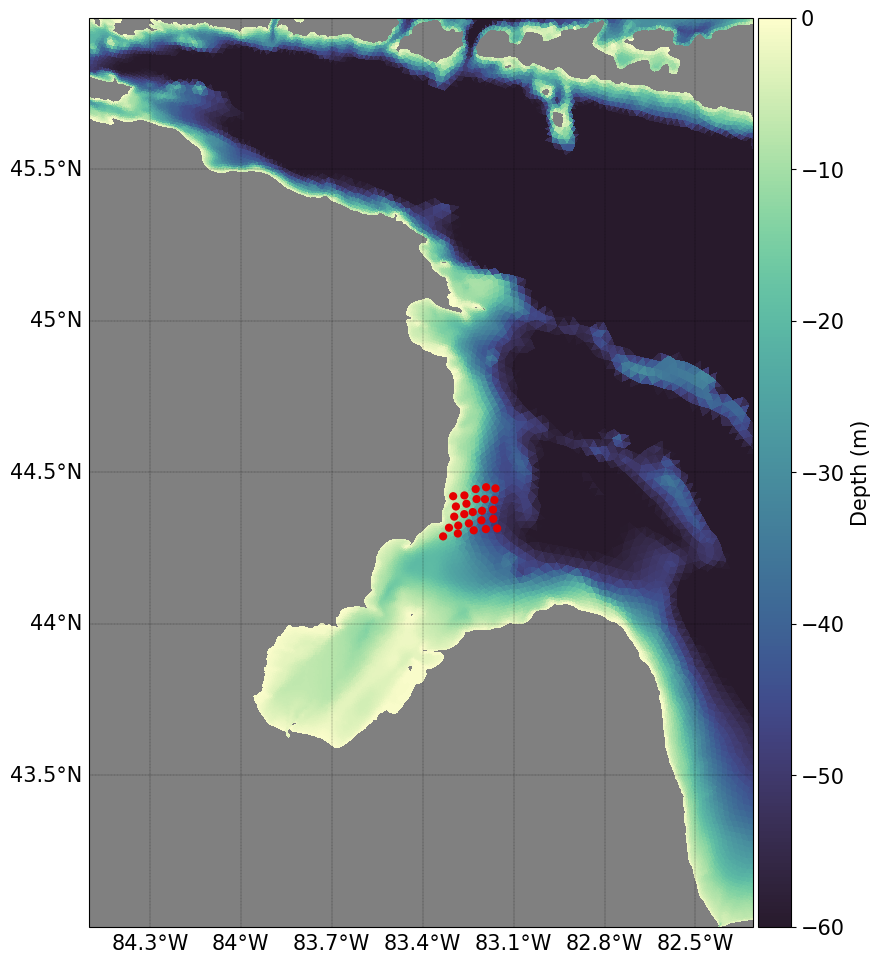

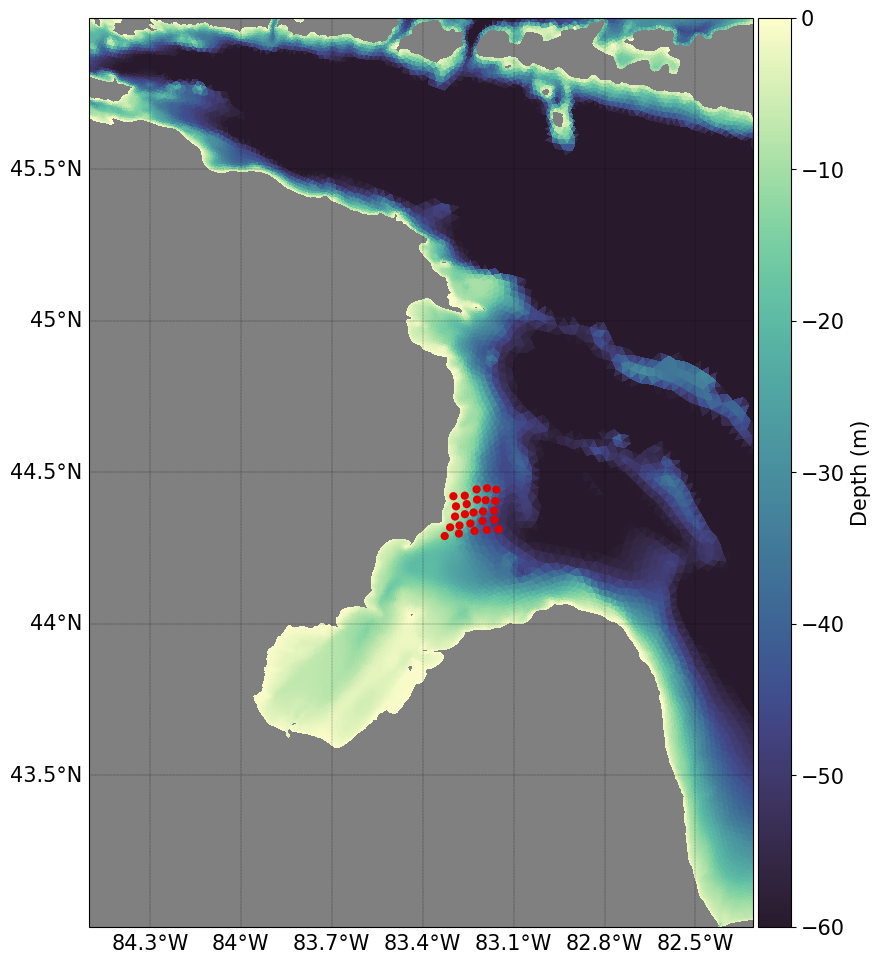

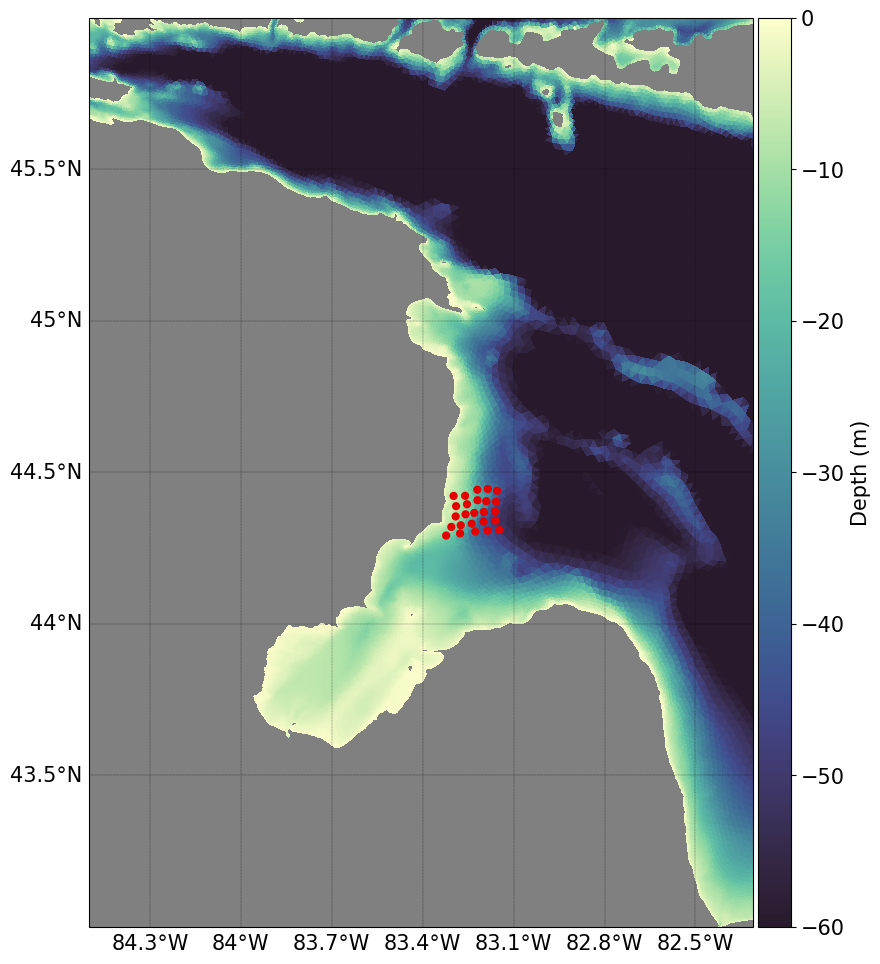

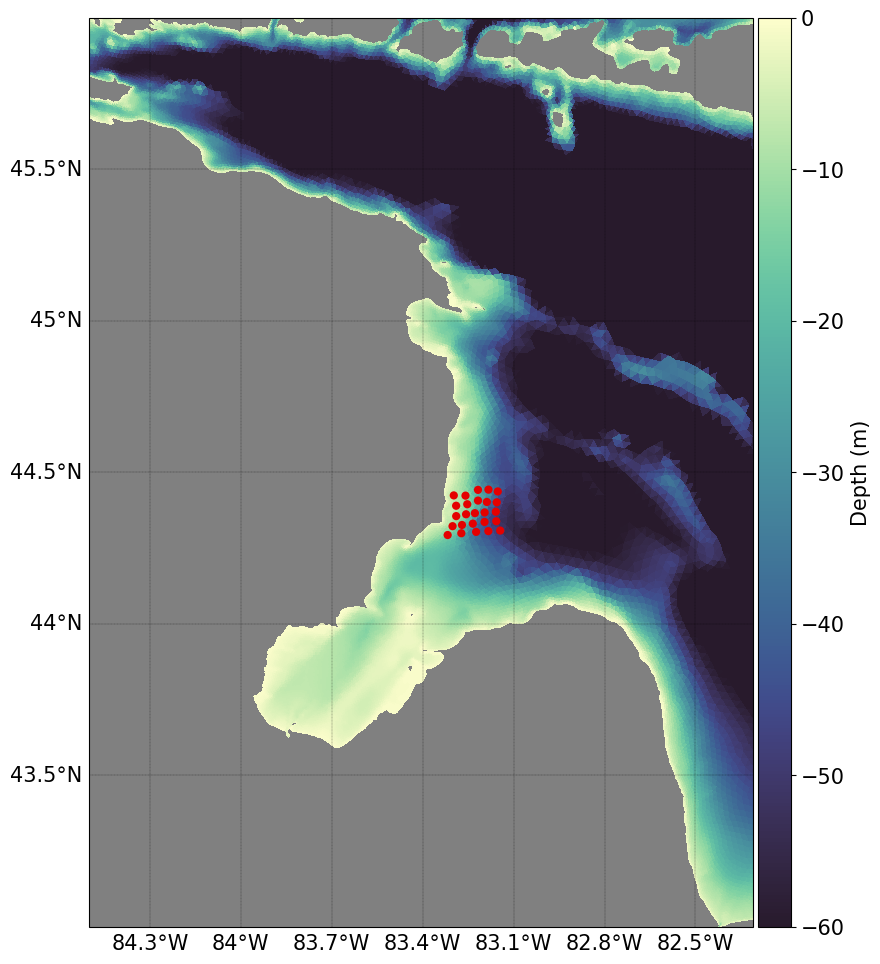

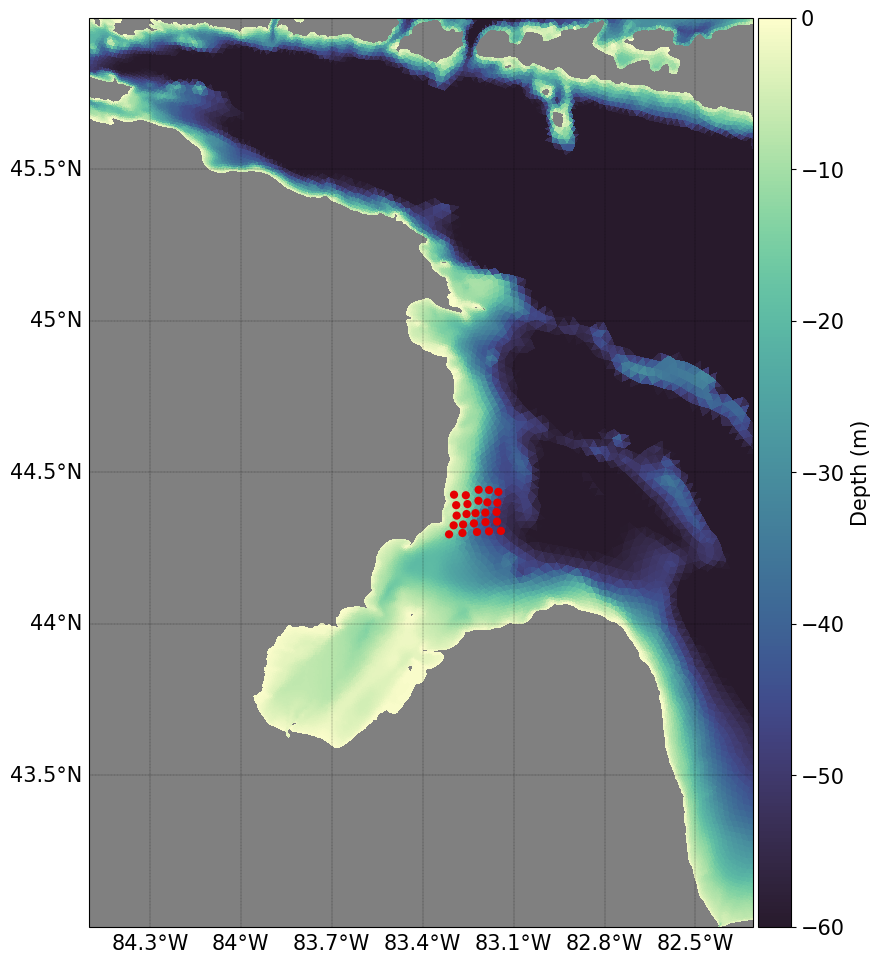

: 

In [12]:
from datetime import timedelta
from pylag.processing.ncview import Viewer

for file_name in sorted(filter (lambda x : x.endswith("nc"),os.listdir('/home/samin/data/FVCOME_OUTPUT/simulations/horon/output/moredata/202301')),key= lambda x : int(x.split(".")[0].split("_")[1])):
    #print(file_name)
    #continue
    #if file_name.endswith("nc"):
    sample_name = file_name
    file_name = '/home/samin/data/FVCOME_OUTPUT/simulations/horon/output/moredata/202301/' + file_name 
    # Time of flight
    time_of_flight = timedelta(hours=12)
    font_size = 15
    # Plot extents
    #extents = np.array([275, 276, 45.5, 46], dtype=float)
    #Ausable watershed
    #extents = np.array([270, 275, 40, 45], dtype=float)
    extents = np.array([275.5,277.69, 43,46], dtype=float)
    fig, ax = create_figure(figure_size=(30., 30.), projection=ccrs.PlateCarree(),
                            font_size=font_size, bg_color='gray')

    # Configure plotter
    plotter = FVCOMPlotter(grid_metrics_file_name,
                           geographic_coords=True,
                           font_size=font_size)

    # Plot the bathymetry again. We'll overlay pathlines on top of this.
    plotter.plot_field(ax, bathy, extents= extents, add_colour_bar=True, cb_label='Depth (m)',
                       vmin=-60., vmax=0., cmap=cmap)

    # Dataset holding particle positions
    viewer = Viewer(file_name, time_rounding=900)

    # Get time index
    date = viewer.date[0] + time_of_flight
    time_index = viewer.date.tolist().index(date)
    n_times = viewer.date[:time_index+1].shape[0]

    # Convert positions into lons/lats
    #lons, lats = lonlat_from_utm(viewer('latitude')[time_index, :].squeeze(),
                                # viewer('longitude')[time_index, :].squeeze(), epsg_code=epsg_code)
    lons,lats = [viewer('longitude')[time_index,:].squeeze(), viewer('latitude')[time_index, :].squeeze()]

    # Plot particle final positions
    ax, scatter = plotter.scatter(ax, lons, lats, s=35, color='#e50000', edgecolors='none')

    # Convert all path line coordinates into lons/lats
    #for i in range(0,60):
        #lons_paths, lats_paths = (viewer('longitude')[:i+1, :],
                                       # viewer('latitude')[:i+1, :])
    lons_paths, lats_paths = (viewer('longitude')[:time_index+1, :],
                                             viewer('latitude')[:time_index+1, :])
    # Add path lines
    #ax, lines = plotter.plot_lines(ax, lons_paths, lats_paths, linewidth=.50, alpha=1, color='y')
    output_directory = '/home/samin/data/FVCOME_OUTPUT/simulations/horon/results/2301/change_releasezone/'
    # for i in range(1, 11):
    #     name = os.path.join(output_directory, f'figure_{i}.png')
    plt.savefig(output_directory+sample_name.split(".")[0]+ ".png",dpi=300)
    #plt.close()